# <div style="font-family: Cambria; font-weight:bold; letter-spacing: 0px; color:white; font-size:200%; text-align:center;padding:3.0px; background: #6A1B9A; border-bottom: 8px solid #9C27B0">S3E26 - BOOSTING (SINGLE)</div>
Notebook edited from [dreygaen/ps3e25-cirrhosis-multi-class-solution](https://www.kaggle.com/code/dreygaen/ps3e25-cirrhosis-multi-class-solution)
#### <div style= "font-family: Cambria; font-weight:bold; letter-spacing: 0px; color:white; font-size:150%; text-align:left;padding:3.0px; background: #6A1B9A; border-bottom: 8px solid #9C27B0" >TABLE OF CONTENTS<br><div>
* [IMPORTS](#1)
* [LOAD DATA](#2)
* [EDA AND VISUALS](#3)
* [FEATURE ENGINEERING](#4)

<a id="1"></a>
# <div style= "font-family: Cambria; font-weight:bold; letter-spacing: 0px; color:white; font-size:120%; text-align:left;padding:3.0px; background: #6A1B9A; border-bottom: 8px solid #9C27B0" > IMPORTS<br><div> 

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm.auto import tqdm
import time
import zipfile

from category_encoders import OneHotEncoder, MEstimateEncoder, GLMMEncoder, OrdinalEncoder, CatBoostEncoder
from sklearn.model_selection import RepeatedStratifiedKFold, StratifiedKFold, GridSearchCV, KFold, cross_val_score
from sklearn.ensemble import (ExtraTreesRegressor, RandomForestRegressor, GradientBoostingRegressor, 
                              RandomForestClassifier, GradientBoostingClassifier, HistGradientBoostingClassifier, 
                              HistGradientBoostingRegressor, VotingRegressor, StackingRegressor, AdaBoostRegressor, StackingClassifier)
from sklearn.linear_model import Ridge, Lasso
from sklearn.linear_model import QuantileRegressor
from sklearn.linear_model import HuberRegressor
from sklearn.cross_decomposition import PLSRegression
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import median_absolute_error, roc_auc_score, roc_curve, log_loss
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.base import BaseEstimator, TransformerMixin, RegressorMixin, clone
from sklearn.preprocessing import FunctionTransformer, StandardScaler, MinMaxScaler, PowerTransformer, LabelEncoder, RobustScaler
from sklearn.compose import ColumnTransformer
from sklearn.calibration import CalibratedClassifierCV
from scipy import stats
from scipy.cluster import hierarchy
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.spatial.distance import squareform
from xgboost import XGBRegressor, XGBClassifier
from lightgbm import LGBMRegressor, LGBMClassifier, early_stopping
from catboost import CatBoostRegressor, CatBoostClassifier
from sklego.linear_model import LADRegression
import optuna
from itertools import combinations, permutations

optuna.logging.set_verbosity(optuna.logging.WARNING)

import warnings
warnings.filterwarnings('ignore')

%matplotlib inline
tqdm.pandas()

rc = {
    'axes.facecolor': '#FFEDED',
    'figure.facecolor': '#FFEDED',
    'axes.edgecolor': '#000000',
    'grid.color': '#EBEBE7',
    'font.family': 'serif',
    'axes.labelcolor': '#000000',
    'xtick.color': '#000000',
    'ytick.color': '#000000',
    'grid.alpha': 0.4
}

font = {'family': 'serif',
        'color':  'black',
        'weight': 'bold',
        'size': 16,
        }

sns.set(rc=rc)

from colorama import Style, Fore
red = Style.BRIGHT + Fore.RED
blu = Style.BRIGHT + Fore.BLUE
mgt = Style.BRIGHT + Fore.MAGENTA
gld = Style.BRIGHT + Fore.YELLOW
res = Style.RESET_ALL
bold_start = Style.BRIGHT
bold_end = Style.NORMAL

target_col = 'Status'

In [2]:
def train_model(train_data, model, features, n_splits, kfold_seed):
    
    model_name = str(model).split("(")[0]
    test_preds = np.zeros((len(test), 3))
    oof_full = np.zeros((len(train_data), 3))
    val_scores, models = [], []
    
    print(model_name)
    
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=kfold_seed)
    skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=kfold_seed)
    
    for i, (train_idx, val_idx) in enumerate(tqdm(skf.split(train_data[features], train_data[target_col]))):

        X_train, X_val = train_data[features].loc[train_idx], train_data[features].loc[val_idx]
        y_train, y_val = train_data[target_col].loc[train_idx], train_data[target_col].loc[val_idx]
        
        if model_name in ["LGBMRegressor", "LGBMClassifier"]:
            callbacks = [early_stopping(stopping_rounds=50)]
            model.fit(X_train, y_train, eval_set=[(X_val, y_val)], callbacks=callbacks)
        elif model_name in ["XGBClassifier", "CatBoostClassifier"]:
            model.fit(X_train, y_train, eval_set=[(X_val, y_val)], verbose=10000)
        else:
            model.fit(X_train, y_train)
        
        oof_preds = model.predict_proba(X_val[features])
        test_preds += model.predict_proba(test[features]) / n_splits
 
        oof_full[val_idx] = oof_preds
        score = log_loss(y_val, oof_preds)
        
        models.append(model)
        val_scores.append(score)
            
        print(f"{red}FOLD {i + 1} log_loss: {round(score, 4)}{res}")
        
    print(f'{red}mean log_loss across all folds: {np.mean(val_scores):.5f}{res}')
    print(f'{red}std of log_loss across all folds: {np.std(val_scores):.5f}{res}')
    
    return oof_full, test_preds, models

<a id="2"></a>
# <div style= "font-family: Cambria; font-weight:bold; letter-spacing: 0px; color:white; font-size:120%; text-align:left;padding:3.0px; background: #6A1B9A; border-bottom: 8px solid #9C27B0" > LOAD DATA<br><div> 

In [29]:
with zipfile.ZipFile('../../../res/data/playground-series-s3e26.zip', 'r') as z:
    
    with z.open('train.csv') as f:
        train = pd.read_csv(f, index_col = 'id')        
                
    with z.open('test.csv') as f:
        test = pd.read_csv(f, index_col = 'id')
    
    with z.open('sample_submission.csv') as f:
        submission = pd.read_csv(f)
        
with zipfile.ZipFile('../../../res/data/cirrhosis-patient-survival-prediction.zip', 'r') as z:
    with z.open('cirrhosis.csv') as f:
        orig_data = pd.read_csv(f, index_col = 'ID') 

<a id="3"></a>
# <div style= "font-family: Cambria; font-weight:bold; letter-spacing: 0px; color:white; font-size:120%; text-align:left;padding:3.0px; background: #6A1B9A; border-bottom: 8px solid #9C27B0" > EDA AND VISUALS<br><div>

In [4]:
num_cols = train.select_dtypes(include = ['float64', 'int64']).columns
cat_cols = train.select_dtypes(include = ['O']).columns

<div style='border-radius:10px; border:#590d0d solid; padding: 15px; background-color: #FFEDED; font-size:100%; text-align:left'>

<h2 align='center' style='color:#590d0d; text-decoration:underline;'>💡 Data Summary</h2>

- **Total Number of Variables:** 19
- **Total Number of Rows:** 7905 
- **Data Types:**
  * **Float64:** 10 ('Bilirubin', 'Cholesterol', 'Albumin', 'Copper', 'Alk_Phos', 'SGOT', 'Tryglicerides', 'Platelets', 'Prothrombin' and 'Stage')
  * **Int64:** 2 ('N_Days' and 'Age')
  * **Object:** 7 ('Drug', 'Sex', 'Ascites', 'Hepatomegaly', 'Spiders', 'Edema' and 'Status')
- **Missing Values:** None (All variables have 0 missing values)
- **Target Variable:** 'Status' (Multi-Class)
    
* **
    
<h2 align='center' style='color:#590d0d; text-decoration:underline;'>📌 Important Notes</h2>

- There are no missing values in the train dataset.
- The target variable is 'Status' which is multi-class and represents whether the patient was alive, alive due to a liver transplant or deceased at n days.

<div style='border-radius:10px; border:#590d0d solid; padding: 15px; background-color: #FFEDED; font-size:100%; text-align:left'>
    
<h2 align='center' style='color:#590d0d; text-decoration:underline;'>🎯 Target Value Distribution</h2>
    
We can observe that there is a vast majority of patients being alive after n days (63%), a second large part being deceased after n days (34%), and only a few entries being alive due to a liver transplant (3%). We can observe the same way of distribution in the original dataset.

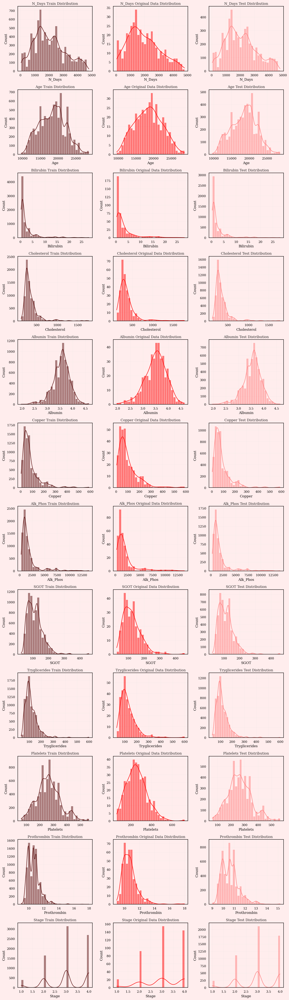

In [5]:
fig, ax = plt.subplots(len(num_cols), 3, figsize=(14, len(num_cols)*4))

for idx, column in enumerate(num_cols):
    sns.histplot(x=column, data=train, bins=30, color='#590d0d', kde=True, ax=ax[idx,0])
    ax[idx,0].set_title(f'{column} Train Distribution')
    
    sns.histplot(x=column, data=orig_data, bins=30, color='red', kde=True, ax=ax[idx,1])
    ax[idx,1].set_title(f'{column} Original Data Distribution')
    
    sns.histplot(x=column, data=test, bins=30, color='#ff8080', kde=True, ax=ax[idx,2])
    ax[idx,2].set_title(f'{column} Test Distribution')
    
plt.tight_layout() 
plt.show()

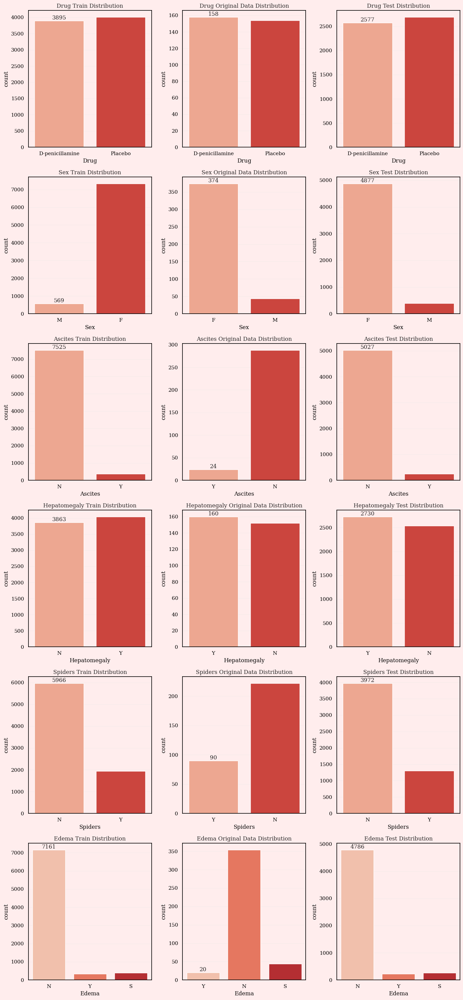

In [6]:
cat_cols = cat_cols.drop(target_col)

fig, ax = plt.subplots(len(cat_cols), 3, figsize=(14, len(cat_cols)*5))

for idx, column in enumerate(cat_cols):
    sns.countplot(x=column, data=train, palette='Reds', ax=ax[idx,0])
    ax[idx,0].set_title(f'{column} Train Distribution')
    ax[idx,0].bar_label(ax[idx,0].containers[0])
    
    sns.countplot(x=column, data=orig_data, palette='Reds', ax=ax[idx,1])
    ax[idx,1].set_title(f'{column} Original Data Distribution')
    ax[idx,1].bar_label(ax[idx,1].containers[0])
    
    sns.countplot(x=column, data=test, palette='Reds', ax=ax[idx,2])
    ax[idx,2].set_title(f'{column} Test Distribution')
    ax[idx,2].bar_label(ax[idx,2].containers[0])
    
plt.tight_layout() 
plt.show()

In [7]:
train = pd.concat([train, orig_data], axis=0, ignore_index=True)

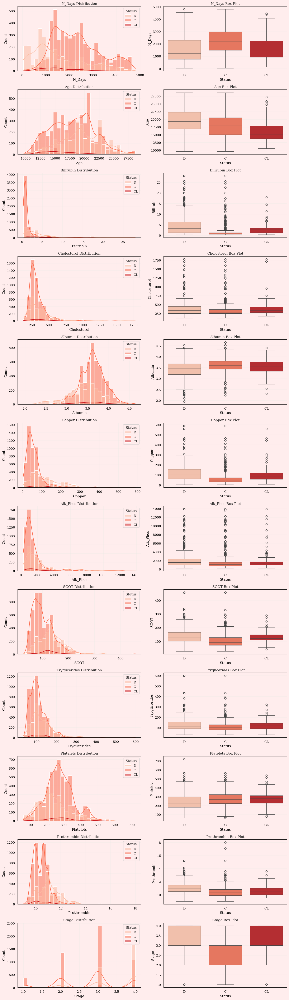

In [8]:
fig, ax = plt.subplots(len(num_cols), 2, figsize=(14, len(num_cols)*4))

for idx, column in enumerate(num_cols):
    sns.histplot(x=column, hue=target_col, data=train, bins=30, kde=True, palette='Reds', ax=ax[idx,0])
    ax[idx,0].set_title(f'{column} Distribution')
    
    sns.boxplot(x=target_col, y=column, data=train, palette='Reds', ax=ax[idx,1])
    ax[idx,1].set_title(f'{column} Box Plot')
    
plt.tight_layout() 
plt.show()

<a id="4"></a>
# <div style= "font-family: Cambria; font-weight:bold; letter-spacing: 0px; color:white; font-size:120%; text-align:left;padding:3.0px; background: #6A1B9A; border-bottom: 8px solid #9C27B0" > FEATURE ENGINEERING<br><div> 

In [37]:
# original notebook applied fit_transform on training data.
train_cat_cols = train.select_dtypes(include=['object']).columns
for col in train_cat_cols:
    label_encoder = LabelEncoder()
    train[col] = label_encoder.fit_transform(train[col])
    if col != target_col:
        test[col] = label_encoder.transform(test[col])

In [11]:
# to_scale = test.columns
# 
# scaler = StandardScaler()
# scaled_train = scaler.fit_transform(train[to_scale])
# scaled_test = scaler.fit_transform(test[to_scale])
# 
# train[to_scale] = scaled_train
# test[to_scale] = scaled_test

In [10]:
# train_drop = train.dropna()
# X = train_drop.drop([target_col], axis=1)
# y = train_drop[target_col]

X = train.drop([target_col], axis=1)
y = train[target_col]

<a id="5"></a>
# <div style= "font-family: Cambria; font-weight:bold; letter-spacing: 0px; color:white; font-size:120%; text-align:left;padding:3.0px; background: #6A1B9A; border-bottom: 8px solid #9C27B0" > MODELS<br><div> 

In [69]:
cat_params = {
            'iterations':470,
            'depth': 20,
            'num_leaves': 31,
            'learning_rate': 0.138112945166,
            'l2_leaf_reg': 4.0368544113430485,
            'random_strength': 0.1279482215776108,
            'max_bin': 238,
            'od_wait': 49,
            'one_hot_max_size': 39,
            'grow_policy': 'Lossguide',
            'bootstrap_type': 'Bernoulli',
            'od_type': 'Iter',    
            'min_data_in_leaf': 11
}

xgb_params = {
    'objective': 'multi_logloss', 
    'max_depth': 6, 
    'learning_rate': 0.010009541152584345, 
    'n_estimators': 1878,
    'min_child_weight': 9, 
    'colsample_bytree': 0.3292032860985591, 
    'reg_alpha': 0.10626128775335533, 
    'reg_lambda': 0.624196407787772, 
    'random_state': 42,
    'tree_method': 'hist', 
    'eval_metric': 'mlogloss',
    'subsample': 0.47524425009347593
}

lgbm_params = {
    'objective': 'multiclass', #'multi_logloss', 
    # 'num_class': 3,
    'max_depth': 9, 
    'num_leaves': 1000,
    'min_child_samples': 14, 
    'learning_rate': 0.034869481921747415, 
    'n_estimators': 274, 
    'min_child_weight': 9, 
    'colsample_bytree': 0.1702910221565107, 
    'reg_alpha': 0.10626128775335533, 
    'reg_lambda': 0.624196407787772, 
    'random_state': 42
}

N_FOLDS = 5
N_REPEATS = 3
EARLY_STOP = 100

In [59]:
cat_models = []
cat_preds = []

k_fold = RepeatedStratifiedKFold(n_splits=N_FOLDS, n_repeats=N_REPEATS, random_state=42)

for train_index, test_index in k_fold.split(X, y):
    X_train, X_valid = X.iloc[train_index], X.iloc[test_index]
    y_train, y_valid = y.iloc[train_index], y.iloc[test_index]
    
    cat = CatBoostClassifier(**cat_params)
    cat.fit(X=X_train, y=y_train, eval_set=[(X_valid, y_valid)], early_stopping_rounds=EARLY_STOP, verbose=False)
    cat_models.append(cat)
    cat_preds.append(cat.predict_proba(test))

In [57]:
xgb_models = []
xgb_preds = []

k_fold = RepeatedStratifiedKFold(n_splits=N_FOLDS, n_repeats=N_REPEATS, random_state=42)

for train_index, test_index in k_fold.split(X, y):
    X_train, X_valid = X.iloc[train_index], X.iloc[test_index]
    y_train, y_valid = y.iloc[train_index], y.iloc[test_index]
    
    xgb = XGBClassifier(**xgb_params)
    xgb.fit(X=X_train, y=y_train, eval_set=[(X_valid, y_valid)], early_stopping_rounds=EARLY_STOP, verbose=False)
    xgb_models.append(xgb)
    xgb_preds.append(xgb.predict_proba(test))

In [71]:
lgbm_models = []
lgbm_preds = []

k_fold = RepeatedStratifiedKFold(n_splits=N_FOLDS, n_repeats=N_REPEATS, random_state=42)

for train_index, test_index in k_fold.split(X, y):
    X_train, X_valid = X.iloc[train_index], X.iloc[test_index]
    y_train, y_valid = y.iloc[train_index], y.iloc[test_index]
    
    lgbm = LGBMClassifier(**lgbm_params)
    lgbm.fit(X=X_train, y=y_train, eval_set=[(X_valid, y_valid)],
             verbose_eval = -1,
             # early_stopping_rounds=EARLY_STOP, 
             # verbose=False
             )
    lgbm_models.append(lgbm)
    lgbm_preds.append(lgbm.predict_proba(test))
    


TypeError: LGBMClassifier.fit() got an unexpected keyword argument 'verbose_eval'

In [45]:

xgb_params = {
    'objective': 'multi_logloss', 
    # 'max_depth': 6, 
    # 'learning_rate': 0.010009541152584345, 
    # 'n_estimators': 1878,
    # 'min_child_weight': 9, 
    'colsample_bytree': 0.3292032860985591, 
    'reg_alpha': 0.10626128775335533, 
    'reg_lambda': 0.624196407787772, 
    'random_state': 42,
    'tree_method': 'hist', 
    'eval_metric': 'mlogloss',
    'subsample': 0.47524425009347593
}

cat_params = {
    # 'iterations':470,
    # 'depth': 20,
    # 'learning_rate': 0.138112945166,
    'l2_leaf_reg': 4.0368544113430485,
    'random_strength': 0.1279482215776108,
    # 'max_bin': 238,
    'od_wait': 49,
    'one_hot_max_size': 39,
    'grow_policy': 'Lossguide',
    'bootstrap_type': 'Bernoulli',
    'od_type': 'Iter',    
    'min_data_in_leaf': 11
}

lgbm_params = {
    'objective': 'multiclass', #'multi_logloss', 
    'num_class': 3,
    # 'max_depth': 9, 
    # 'min_child_samples': 14, 
    # 'learning_rate': 0.034869481921747415, 
    # 'n_estimators': 274, 
    'min_child_weight': 9, 
    'colsample_bytree': 0.1702910221565107, 
    'reg_alpha': 0.10626128775335533, 
    'reg_lambda': 0.624196407787772, 
    'random_state': 42,

}


def objective(trial):
    max_depth=trial.suggest_int("max_depth_uni", 5, 25, log=False)
    learning_rate=trial.suggest_float("learning_rate_uni", 0.009, 0.05, log=False)
    n_estimators = trial.suggest_int("n_estimators_uni", 100, 1000, log=False)
    # List of potential classifiers
    classifier_options = {
        "XGBClassifier": XGBClassifier(
            max_depth=max_depth,
            min_child_weight=trial.suggest_int("xgb_min_child_weight_uni", 1, 20, log=False),
            learning_rate=learning_rate,
            n_estimators=n_estimators,
            **xgb_params
        ),
        "CatBoostClassifier": CatBoostClassifier(
            # depth=trial.suggest_int("cat_depth_uni", 2, 32, log=False),
            max_depth=max_depth,
            max_bin=trial.suggest_int("cat_max_bin_uni", 50, 500, log=False),
            learning_rate=10*learning_rate,
            n_estimators=n_estimators,
            **cat_params
        ),
        "LGBMClassifier": LGBMClassifier(
            max_depth=max_depth,
            num_leaves=2**max_depth - 1 if 2**max_depth - 1 <= 131072 else 131072,
            min_child_samples=trial.suggest_int("lgbm_min_child_samples_uni", 10, 30, log=False),
            min_gain_to_split=trial.suggest_float("lgbm_min_gain_to_split2", 0.0, 0.1, step=0.01),
            learning_rate=learning_rate,
            n_estimators=n_estimators,
            **lgbm_params
        ),
    }

    # Select A classifiers    
    selected_classifier = trial.suggest_categorical("base_classifiers", list(classifier_options.keys()))
    classifier = classifier_options[selected_classifier]

    score = cross_val_score(classifier, X, y, n_jobs=-1, cv=5, scoring='neg_log_loss')
    accuracy = score.mean()
    return accuracy

study = optuna.create_study(
    storage="sqlite:///db.sqlite3",  # Specify the storage URL here.
    study_name="individual-boosting-3",
    direction='maximize',
    load_if_exists=True,
)
study.optimize(objective, n_trials=100)

print(study.best_trial)


[LightGBM] [Warning] min_gain_to_split is set=0.04, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.04
[LightGBM] [Warning] min_gain_to_split is set=0.04, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.04
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.061724 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1950
[LightGBM] [Info] Number of data points in the train set: 6658, number of used features: 18
[LightGBM] [Info] Start training from score -0.470785
[LightGBM] [Info] Start training from score -3.322935
[LightGBM] [Info] Start training from score -1.080454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

In [26]:
best_params = study.best_params

if best_params['base_classifiers'] == 'LGBMClassifier':
    max_depth = best_params['lgbm_max_depth_uni']
    
    model = LGBMClassifier(
        max_depth=max_depth,
        num_leaves=2**max_depth - 1 if 2**max_depth - 1 <= 131072 else 131072,
        min_child_samples=best_params["lgbm_min_child_samples_uni"],
        min_gain_to_split=best_params["lgbm_min_gain_to_split2"],
        **lgbm_params
    )

    model.fit(X, y)

[LightGBM] [Warning] min_gain_to_split is set=0.04, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.04
[LightGBM] [Warning] min_gain_to_split is set=0.04, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.04
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000786 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1962
[LightGBM] [Info] Number of data points in the train set: 8323, number of used features: 18
[LightGBM] [Info] Start training from score -0.470941
[LightGBM] [Info] Start training from score -3.322996
[LightGBM] [Info] Start training from score -1.080160
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

<a id="6"></a>
# <div style= "font-family: Cambria; font-weight:bold; letter-spacing: 0px; color:white; font-size:120%; text-align:left;padding:3.0px; background: #6A1B9A; border-bottom: 8px solid #9C27B0" > SUBMISSION<br><div> 

In [38]:
submission['Status_C'] =  model.predict_proba(test)[:, 0]
submission['Status_D'] =  model.predict_proba(test)[:, 2]
submission['Status_CL'] = model.predict_proba(test)[:, 1]

[LightGBM] [Warning] min_gain_to_split is set=0.04, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.04
[LightGBM] [Warning] min_gain_to_split is set=0.04, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.04
[LightGBM] [Warning] min_gain_to_split is set=0.04, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.04


In [36]:
test.info()
X.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5271 entries, 7905 to 13175
Data columns (total 18 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   N_Days         5271 non-null   int64  
 1   Drug           5271 non-null   object 
 2   Age            5271 non-null   int64  
 3   Sex            5271 non-null   object 
 4   Ascites        5271 non-null   object 
 5   Hepatomegaly   5271 non-null   object 
 6   Spiders        5271 non-null   object 
 7   Edema          5271 non-null   object 
 8   Bilirubin      5271 non-null   float64
 9   Cholesterol    5271 non-null   float64
 10  Albumin        5271 non-null   float64
 11  Copper         5271 non-null   float64
 12  Alk_Phos       5271 non-null   float64
 13  SGOT           5271 non-null   float64
 14  Tryglicerides  5271 non-null   float64
 15  Platelets      5271 non-null   float64
 16  Prothrombin    5271 non-null   float64
 17  Stage          5271 non-null   float64
dtypes: float6

In [39]:
submission.to_csv('submission.csv', index = False)